In [1]:
import pandas as pd
import numpy as np
import datetime as dt
import seaborn as sns
from statsmodels.tsa.stattools import adfuller
import matplotlib.pyplot as plt
get_ipython().run_line_magic('matplotlib', 'inline')
from time import time
import os
from math import sqrt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import itertools
import statsmodels.api as sm
from statsmodels.tsa.stattools import acf,pacf
from statsmodels.tsa.arima_model import  ARIMA
from sklearn import model_selection
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.linear_model import LinearRegression
from pandas import DataFrame
import warnings
warnings.filterwarnings('ignore')

import plotly.figure_factory as ff
import plotly.graph_objects as go
from plotly.graph_objs import Layout
import plotly.express as px

from utilities import plotly_boxplot, plotly_bar, plotly_scatter

pd.options.display.float_format = ' {:,.2f}'.format 
pd.options.display.max_rows = 999
pd.options.display.max_columns = 999



## Exploratory

#### Read in sales data and perform necessary merges

In [2]:
data = pd.read_excel('DI data challenge.xlsx',sheet_name=None)

In [3]:
stores = data['stores']
features = data['features']
#macro = data['macro']
train = data['train']
test = data['test']

In [4]:
stores_feat = stores.merge(features, on='Store')
stores_shape = stores_feat.shape
print(f'Final Store-level data has {stores_shape[0]} rows and {stores_shape[1]} columns')

Final Store-level data has 8190 rows and 14 columns


In [5]:
train_full = train.merge(stores_feat, on =['Store','Date','IsHoliday'])#.merge(macro, left_on='Date', right_on='DATE')
test_full = test.merge(stores_feat, on =['Store','Date','IsHoliday'])#.merge(macro, left_on='Date', right_on='DATE')
train_shape = train_full.shape
print(f'Final Store-level Training data has {train_shape[0]} rows and {train_shape[1]} columns')

Final Store-level Training data has 305982 rows and 17 columns


#### If desired, perform a merge with additional Macroeconomic Data from FRED to test for any correlations

In [6]:
#train_full = train_full.merge(macro, left_on='Date', right_on='DATE').fillna(0)

#### Quick Augmented Dickey Fuller Test to quantify Store-level Stationarity and ACF for Auto-correlations

In [7]:
for num in range(1,46):
    store = train_full[train_full.Store==num]
    store_sales = store.groupby('Date')['Weekly_Sales'].sum().to_frame()
    adf_test = adfuller(store_sales)
    print(f'Store {num}:')
    print(f'ADF p-value: {adf_test[1]}')

Store 1:
ADF p-value: 0.00019195538071253425
Store 2:
ADF p-value: 0.0002898763476350127
Store 3:
ADF p-value: 0.001637357866701197
Store 4:
ADF p-value: 0.00915447534821761
Store 5:
ADF p-value: 0.00030486237525919
Store 6:
ADF p-value: 9.604759424171627e-05
Store 7:
ADF p-value: 0.0009453721770786114
Store 8:
ADF p-value: 0.0001292878918267192
Store 9:
ADF p-value: 0.0004691151410042887
Store 10:
ADF p-value: 0.0002811356125747537
Store 11:
ADF p-value: 1.2413481170314706e-05
Store 12:
ADF p-value: 8.028385462690633e-05
Store 13:
ADF p-value: 0.00013239785975357782
Store 14:
ADF p-value: 9.893652751562281e-05
Store 15:
ADF p-value: 3.375020048133507e-05
Store 16:
ADF p-value: 0.0024445608998170825
Store 17:
ADF p-value: 0.0005123947534443481
Store 18:
ADF p-value: 0.00020838289950409644
Store 19:
ADF p-value: 3.417893375947035e-05
Store 20:
ADF p-value: 0.00020249967097386601
Store 21:
ADF p-value: 1.804065544159723e-05
Store 22:
ADF p-value: 7.965778717480771e-06
Store 23:
ADF p-val

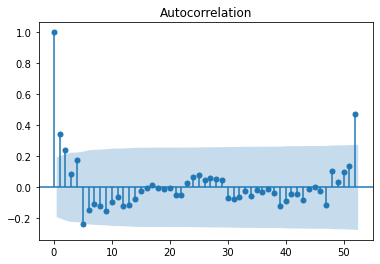

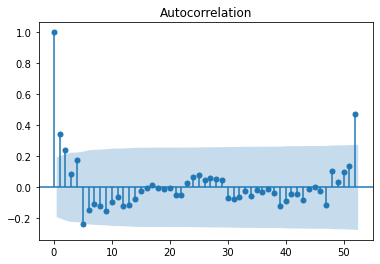

In [8]:
plot_acf(train_full.groupby('Date')['Weekly_Sales'].sum(), lags=52)

## Add Features

In [9]:
def add_features(df, train_month=False, add_dummies=True):
    df['Missing_Promo_Data'] = df.apply(lambda row: 1 if row.Date < pd.Timestamp('2011-11-11') else \
                                                    0, axis=1)
    df['Month'] = df['Date'].dt.month.astype(int)
    df['Year'] = df['Date'].dt.year.astype(int)
    df['Week_of_Year'] = df['Date'].dt.isocalendar().week.astype(int)
    df['Day_of_Month'] = df['Date'].dt.day.astype(int)
    df['IsHoliday_Bin'] = df.apply(lambda row: 1 if row.IsHoliday else 0, axis=1)
    df['Holiday_Label'] = df.apply(lambda row: '4. Pre-Christmas' if row.Week_of_Year==51 and row.Month == 12 else \
                                               '5. Christmas' if row.IsHoliday and row.Month == 12 else \
                                               '3. Thanksgiving' if row.IsHoliday and row.Month == 11 else \
                                               '2. Labor Day' if row.IsHoliday and row.Month == 9 else \
                                               '1. Super Bowl' if row.IsHoliday and row.Month == 2 else \
                                               None, axis=1)
    df['Holiday_Label_Bin'] = df.apply(lambda row: 4 if row.Week_of_Year==51 and row.Month == 12 else \
                                               5 if row.IsHoliday and row.Month == 12 else \
                                               3 if row.IsHoliday and row.Month == 11 else \
                                               2 if row.IsHoliday and row.Month == 9 else \
                                               1 if row.IsHoliday and row.Month == 2 else \
                                               None, axis=1)
    df['Week_of_Month'] = df.apply(lambda row: 'First Week' if row.Day_of_Month <= 8 else \
                                               'Last Week' if row.Day_of_Month > 23 else \
                                               'Other Weeks', axis=1)
    df['Week_of_Month_Bin'] = df.apply(lambda row: 1 if row.Day_of_Month <= 8 else \
                                               3 if row.Day_of_Month > 23 else \
                                               2, axis=1)
    df['Temperature_Bin'] = df.apply(lambda row: 0 if row.Temperature < 10 else \
                                                 10 if row.Temperature < 20 and row.Temperature >= 10 else \
                                                 20 if row.Temperature < 30 and row.Temperature >= 20  else \
                                                 30 if row.Temperature < 40 and row.Temperature >= 30  else \
                                                 40 if row.Temperature < 50 and row.Temperature >= 40  else \
                                                 50 if row.Temperature < 60 and row.Temperature >= 50  else \
                                                 60 if row.Temperature < 70 and row.Temperature >= 60  else \
                                                 70 if row.Temperature < 80 and row.Temperature >= 70  else \
                                                 80 if row.Temperature < 90 and row.Temperature >= 80  else \
                                                 90 if row.Temperature > 90 else 50, axis = 1)
    df['Type_Bin'] = df.apply(lambda row: 1 if row.Type == 'A' else \
                                          2 if row.Type == 'B' else \
                                          3, axis=1)
    if add_dummies:
        df = pd.concat([df, pd.get_dummies(df['Holiday_Label'], prefix='Holiday', drop_first=True)], axis=1)
        df = pd.concat([df, pd.get_dummies(df['Week_of_Month'], drop_first=True)], axis=1)
        df = pd.concat([df, pd.get_dummies(df['Temperature_Bin'], prefix='Temp', drop_first=True)], axis=1)
        if train_month:
            df = pd.concat([df, pd.get_dummies(df['Month'], prefix='Month', drop_first=True)], axis=1)
        else:
            df = pd.concat([df, pd.get_dummies(df['Month'], prefix='Month', drop_first=False)], axis=1)
        df = pd.concat([df, pd.get_dummies(df['Type'], prefix='Type', drop_first=True)], axis=1)
#         df = pd.concat([df, pd.get_dummies(df['Store'], prefix='Store', drop_first=True)], axis=1)
#         df = pd.concat([df, pd.get_dummies(df['Dept'], prefix='Dept', drop_first=True)], axis=1)
        df['const'] = 1
    
    return df


In [10]:
train_full_feat = add_features(train_full, train_month=True)
test_full_feat = add_features(test_full, train_month=False)

## Create EDA Views / Plots

#### Weekly Sales Time Series Plot

In [11]:
layout = Layout(
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    margin=dict(
        l=10,
        r=10,
        b=50,
        t=50,
        pad=1
    ),
    title="Total Weekly Sales Over Time"
)

weekly = train_full.groupby('Date')['Weekly_Sales'].sum().reset_index()
fig = go.Figure(data=go.Scatter(x=weekly['Date'], y=weekly['Weekly_Sales'], mode='lines'), layout=layout)

fig.show()
fig_json = fig.write_html('assets/img/weekly_sales_time_series.html')


#### Weekly Sales Distribution Histogram

In [12]:
layout = Layout(
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    margin=dict(
        l=10,
        r=10,
        b=50,
        t=50,
        pad=1
    ),
    xaxis_title='Total Store Weekly Sales',
    yaxis_title='',
    title="Total Weekly Sales Distribution (by Store)"
)
hist_fig = go.Figure(data=[go.Histogram(x=train_full.groupby('Date')['Weekly_Sales'].sum().reset_index(), nbinsx=100, histnorm='probability')], layout=layout)
hist_fig.show()
hist_json = hist_fig.write_html('assets/img/plotly2.html')

#### Avg Weekly Sales by Department

In [13]:
dept_bar = plotly_bar(train_full.groupby(['Dept'])[['Weekly_Sales', 'Size']].mean().reset_index(),
               'Dept', 'Weekly_Sales', title="Avg Weekly Sales by Department")

dept_bar.write_html('assets/img/dept_bar.html')

#### Avg Weekly Sales by Store Type

In [14]:
type_fig = plotly_boxplot(train_full.groupby(['Store', 'Type'])['Weekly_Sales'].mean().reset_index(),
               'Type', 'Weekly_Sales', title="Weekly Sales vs Store Type", points='all')
type_fig.write_html('assets/img/type_fig.html')

#### Avg Weekly Sales by Store Size

In [15]:
size_fig = plotly_scatter(train_full.groupby(['Store'])[['Weekly_Sales', 'Size']].mean().reset_index(),
               'Size', 'Weekly_Sales', title="Weekly Sales vs Store Size")
size_fig.write_html('assets/img/size_fig.html')

#### Avg Weekly Sales by Temperature

In [16]:
temp_fig = plotly_bar(train_full_feat.groupby(['Store', 'Date'])[['Weekly_Sales', 'Temperature']].mean().reset_index(),
                'Temperature', 'Weekly_Sales', title='Weekly Sales vs Regional Temperature')
temp_fig.write_html(f'assets/img/temp_fig.html')

#### Avg Weekly Sales by Store

In [17]:
store_bar = plotly_bar(train_full.groupby(['Store'])[['Weekly_Sales', 'Size']].mean().reset_index(),
               'Store', 'Weekly_Sales', title="Avg Weekly Sales by Store")
store_bar.write_html('assets/img/store_bar.html')

#### Association Between Store Type and Size

In [18]:
type_size_box = plotly_boxplot(train_full.groupby(['Store', 'Type'])[['Weekly_Sales', 'Size']].mean().reset_index(),
               'Type', 'Size', title="")
type_size_box.write_html('assets/img/store_type_size_box.html')

#### Avg Weekly Sales by Fuel Prices

In [19]:
fuel_fig = plotly_bar(train_full.groupby(['Store', 'Date'])[['Weekly_Sales', 'Fuel_Price']].mean().reset_index(),
                'Fuel_Price', 'Weekly_Sales', title='Weekly Sales vs Fuel Prices')
fuel_fig.write_html(f'assets/img/fuel_fig.html')

#### Avg Weekly Sales by Promotion, with IsHoliday hue

In [20]:
for promo in ['Promo1', 'Promo2','Promo3', 'Promo4','Promo5']:
    promo_fig = px.scatter(train_full_feat.groupby(['Store', 'IsHoliday'])['Weekly_Sales', promo].mean().reset_index(),
                 x=promo, y="Weekly_Sales", color='IsHoliday')
    promo_fig.update_layout(Layout(
                                    paper_bgcolor='rgba(0,0,0,0)',
                                    plot_bgcolor='rgba(0,0,0,0)',
                                    margin=dict(
                                        l=10,
                                        r=10,
                                        b=50,
                                        t=50,
                                        pad=1
                                    ),
                                    title=f'{promo} vs Weekly Sales (by Holiday Flag)'
                                )
                      )
    promo_fig.show()
    promo_fig.write_html(f'assets/img/{promo}_sales.html')

#### Inventory Views

In [21]:
inv_fig = plotly_boxplot(train_full,
                'Inventory', 'Weekly_Sales', title='Weekly Sales vs Inventory', points=False)
inv_fig.write_html(f'assets/img/inv_sales.html')

#### Promotional Markdown by Week of Year

In [22]:
for promo in ['Promo1', 'Promo2','Promo3', 'Promo4','Promo5']:
    plotly_bar(train_full.groupby(['Week_of_Year'])[promo].mean().reset_index(), 
                   'Week_of_Year', promo, title=f'Promotional Markdown #{promo[-1]} Holiday Distribution')

####  Avg Weekly Sales by CPI

In [23]:
cpi_fig = plotly_scatter(train_full.groupby(['Store', 'Year'])[['Weekly_Sales', 'CPI']].mean().reset_index(),
                'CPI', 'Weekly_Sales', title='Weekly Sales vs Regional CPI')
cpi_fig.write_html(f'assets/img/cpi_fig.html')

#### Avg Weekly Sales by Unemployment Rate

In [24]:
employ_fig = plotly_scatter(train_full.groupby(['Store', 'Year'])[['Weekly_Sales', 'Unemployment']].mean().reset_index(),
                'Unemployment', 'Weekly_Sales', title='Weekly Sales vs Unemployment Rate')
employ_fig.write_html(f'assets/img/employ_fig.html')

####  Avg Weekly Sales by Temporal Features

In [25]:
hol_flag = plotly_boxplot(train_full.groupby(['Store', 'IsHoliday'])['Weekly_Sales'].mean().reset_index(),
               'IsHoliday', 'Weekly_Sales', title="Distribution of Weekly Sales by Holiday Flag", points='all')
hol_type = plotly_boxplot(train_full.groupby(['Store', 'Holiday_Label'])['Weekly_Sales'].mean().reset_index(),
               'Holiday_Label', 'Weekly_Sales', title="Distribution of Weekly Sales by Holiday Type", points='all')
week_month = plotly_boxplot(train_full.groupby(['Date', 'Week_of_Month'])['Weekly_Sales'].mean().reset_index(),
               'Week_of_Month', 'Weekly_Sales', title="Distribution of Weekly Sales by Week of Month", points=False)
week_year = plotly_bar(train_full.groupby(['Week_of_Year'])['Weekly_Sales'].mean().reset_index(),
               'Week_of_Year', 'Weekly_Sales', title="Distribution of Weekly Sales by Week of Year")

hol_flag.write_html('assets/img/hol_flag.html')
hol_type.write_html('assets/img/hol_type.html')
week_month.write_html('assets/img/week_month.html')
week_year.write_html('assets/img/week_year.html')

#### Store and Department Level Trends to see if a one-size fits all model could be possible

Store 1


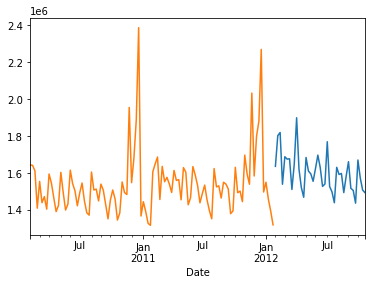

Store 2


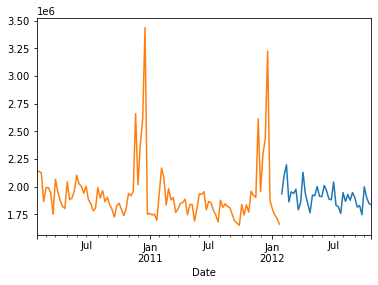

Store 3


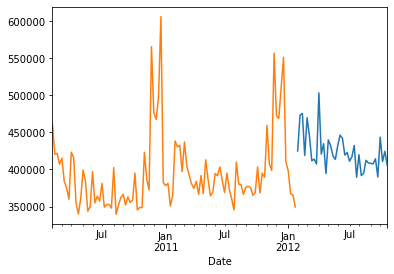

Store 4


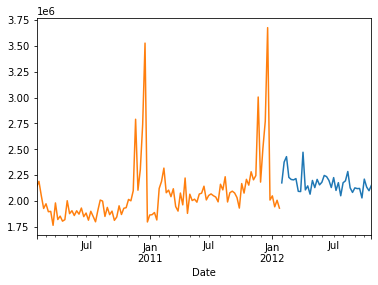

Store 5


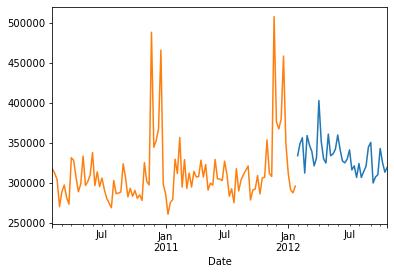

Store 6


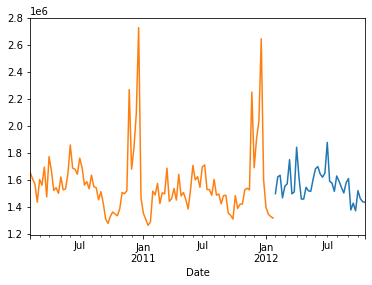

Store 7


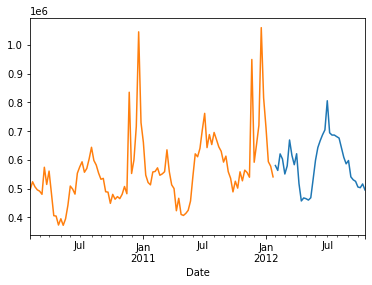

Store 8


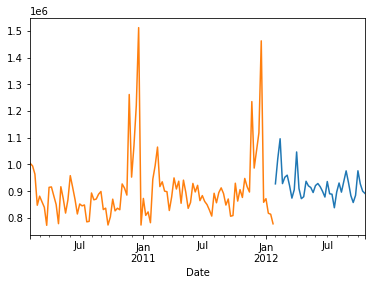

Store 9


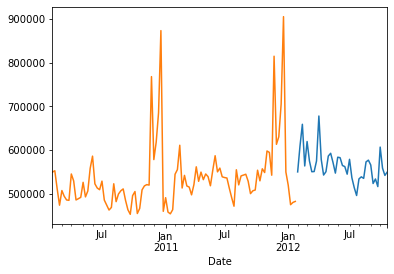

Store 10


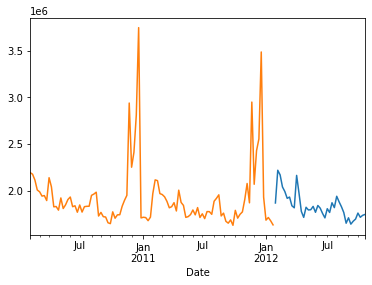

Store 11


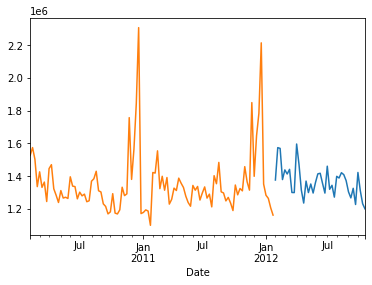

Store 12


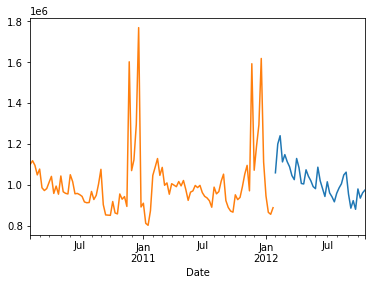

Store 13


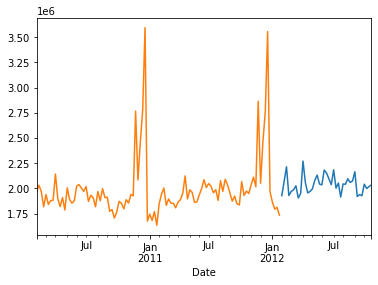

Store 14


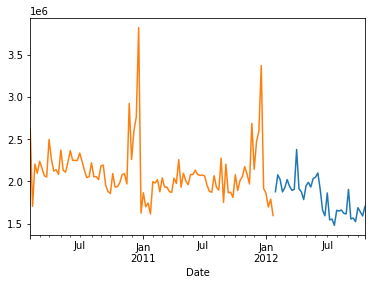

Store 15


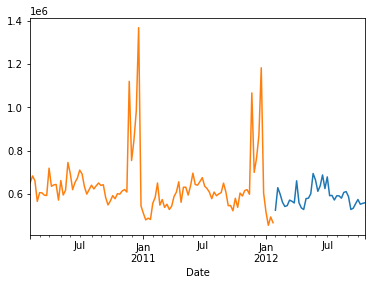

Store 16


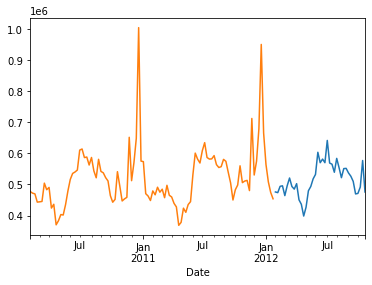

Store 17


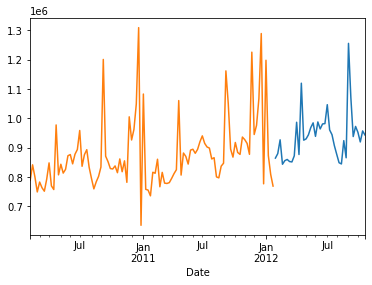

Store 18


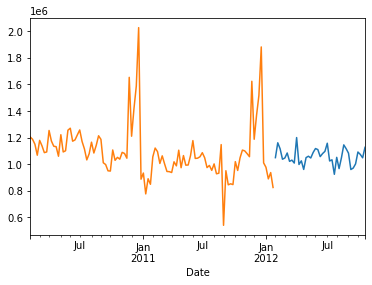

Store 19


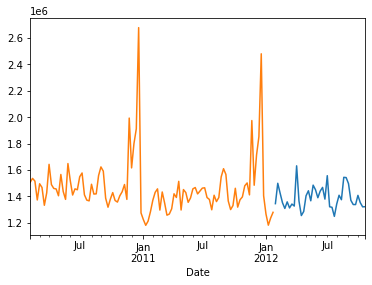

Store 20


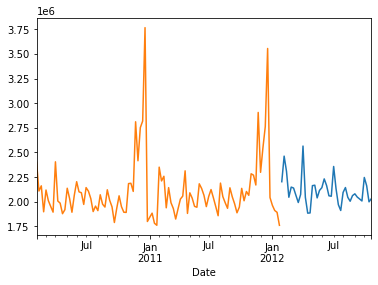

Store 21


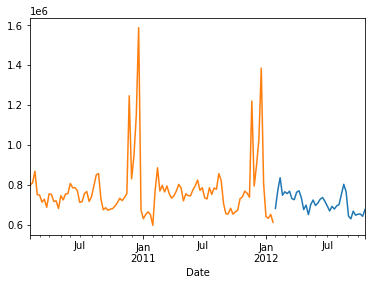

Store 22


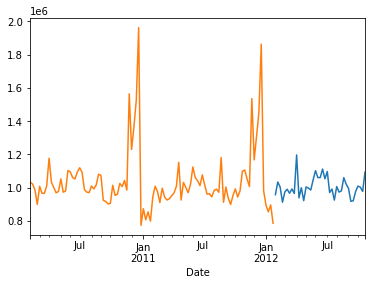

Store 23


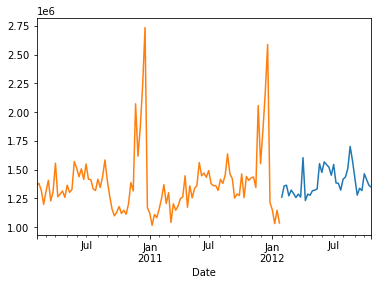

Store 24


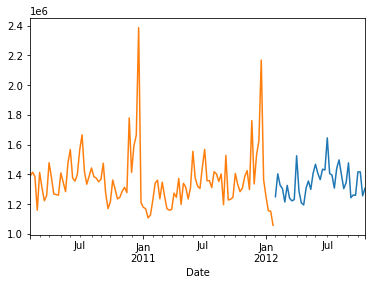

Store 25


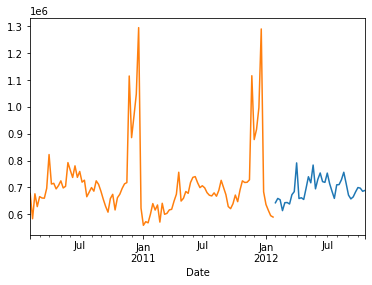

Store 26


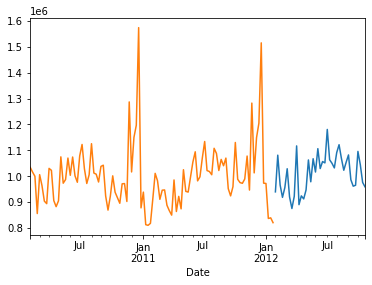

Store 27


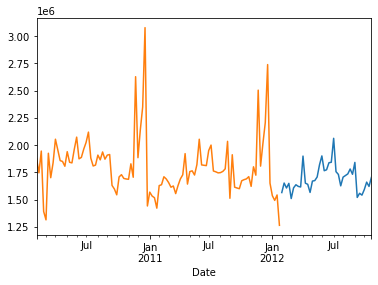

Store 28


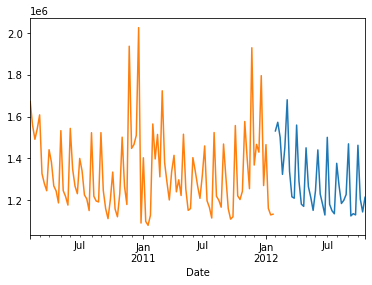

Store 29


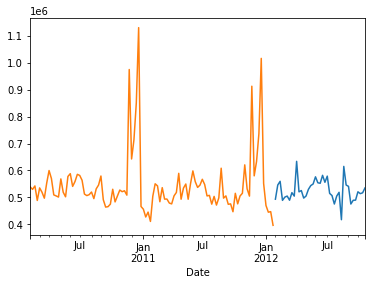

Store 30


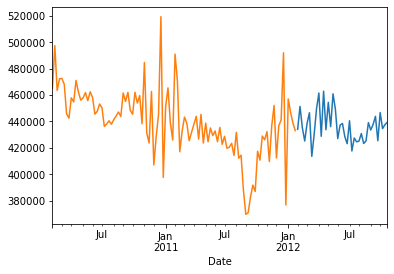

Store 31


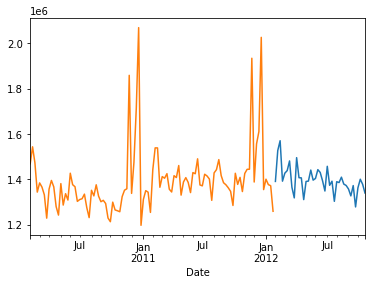

Store 32


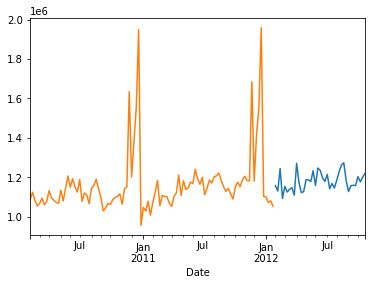

Store 33


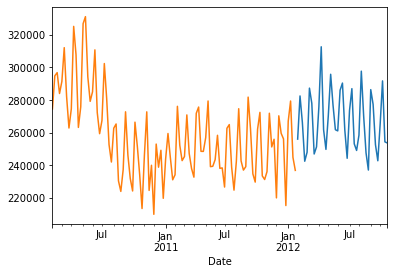

Store 34


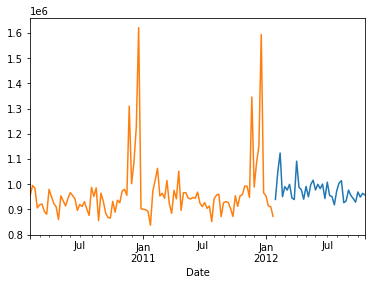

Store 35


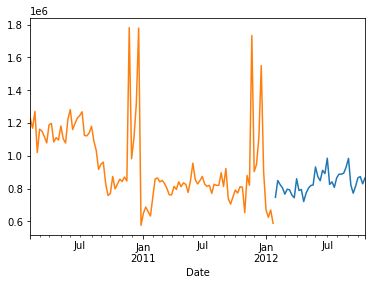

Store 36


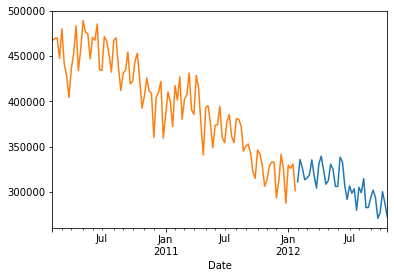

Store 37


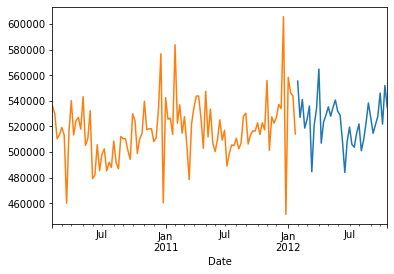

Store 38


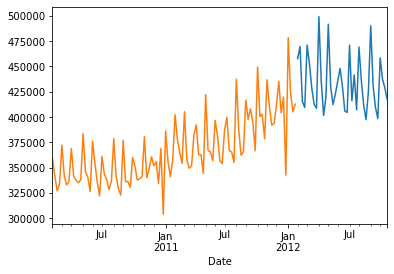

Store 39


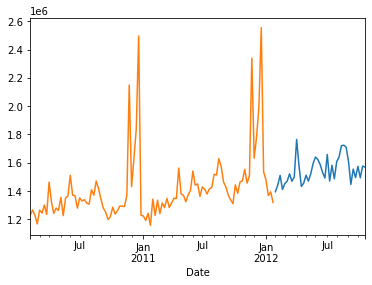

Store 40


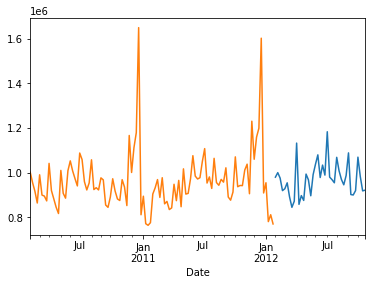

Store 41


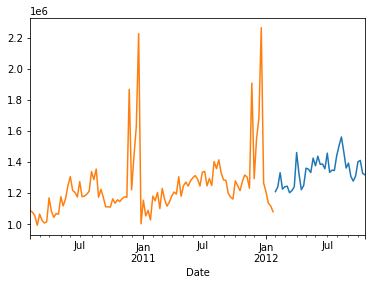

Store 42


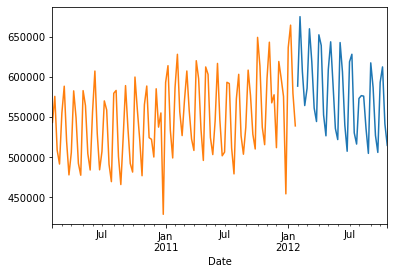

Store 43


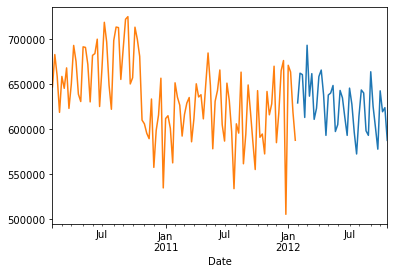

Store 44


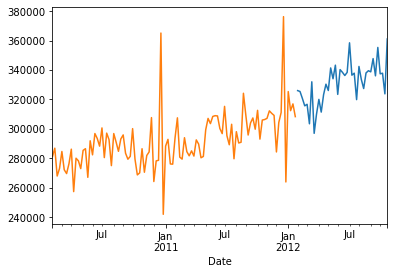

Store 45


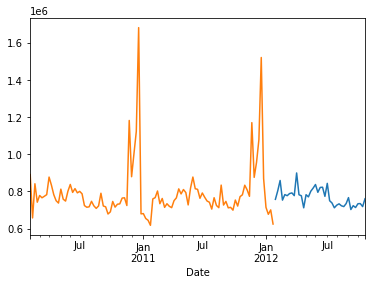

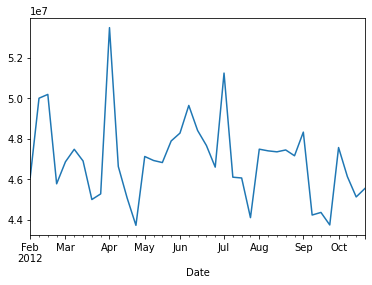

In [26]:
for i in range(1, 46):
    print(f'Store {i}')
    test_full[test_full.Store==i].groupby('Date')['Weekly_Sales'].sum().plot()
    train_full[train_full.Store==i].groupby('Date')['Weekly_Sales'].sum().plot()
    plt.show()
test_full.groupby('Date')['Weekly_Sales'].sum().plot()
plt.show()

Department 1


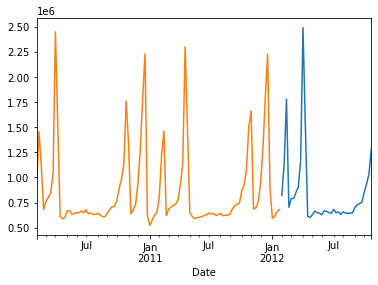

Department 2


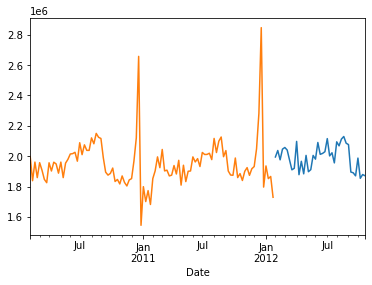

Department 3


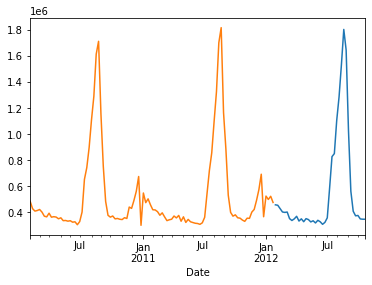

Department 4


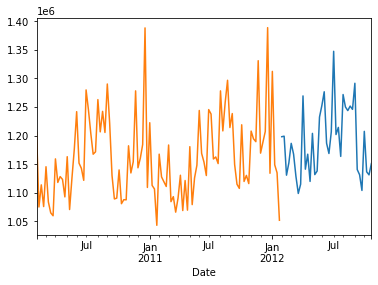

Department 5


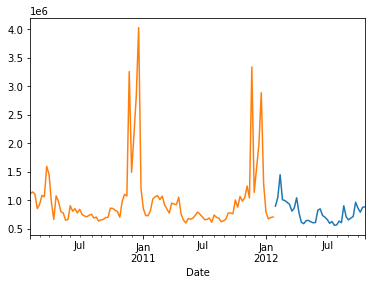

Department 6


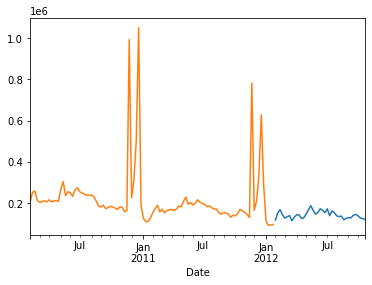

Department 7


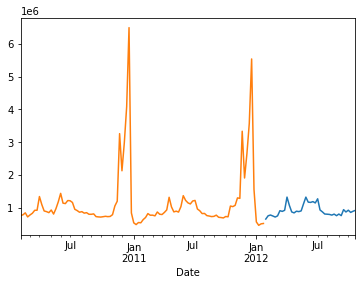

Department 8


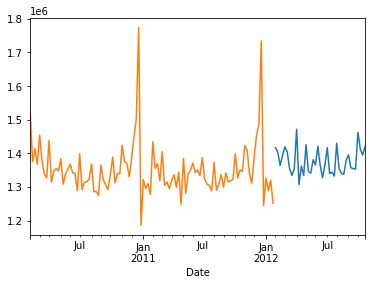

Department 9


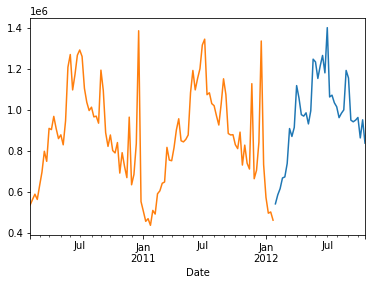

Department 10


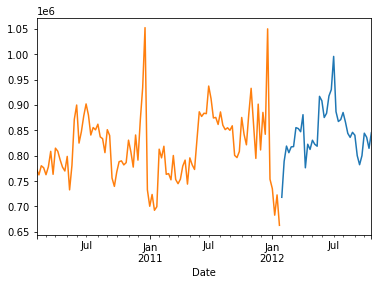

Department 11


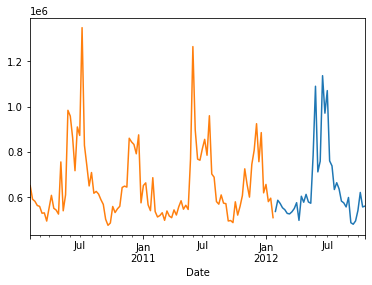

Department 12


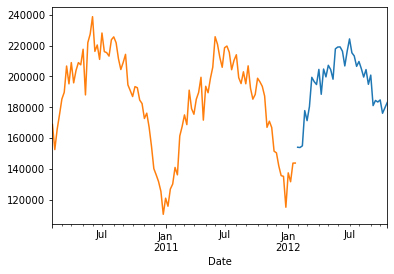

Department 13


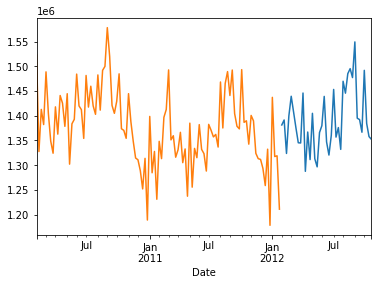

Department 14


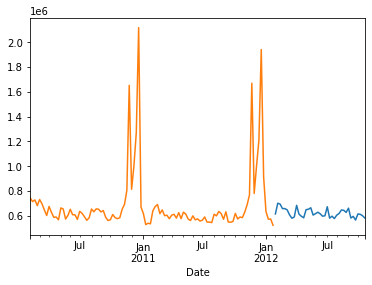

Department 15


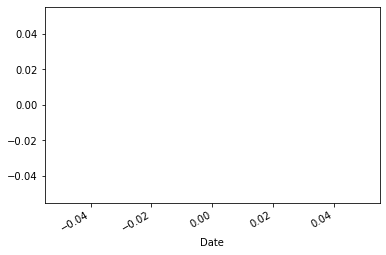

Department 16


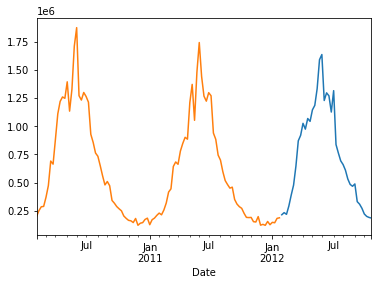

Department 17


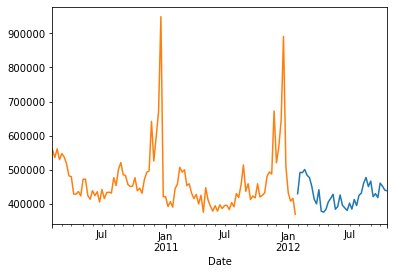

Department 18


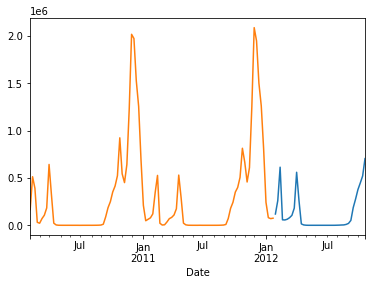

Department 19


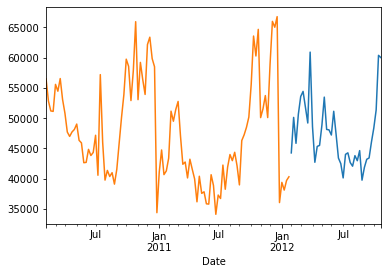

Department 20


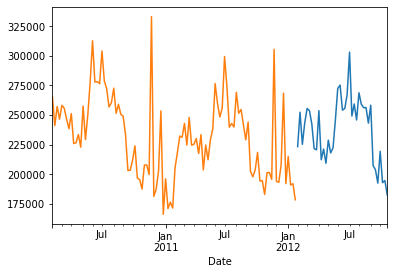

Department 21


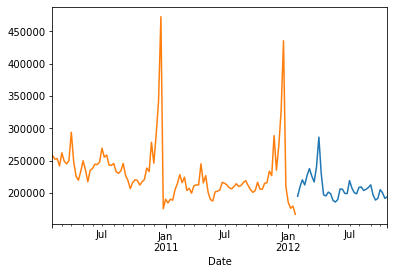

Department 22


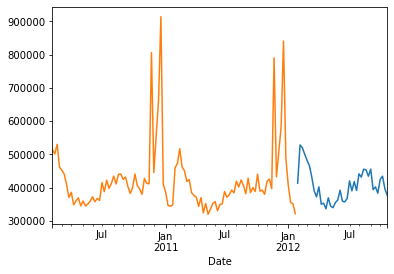

Department 23


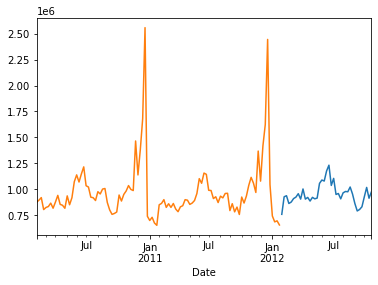

Department 24


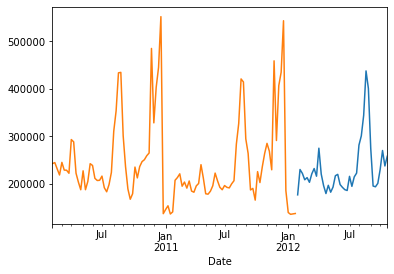

Department 25


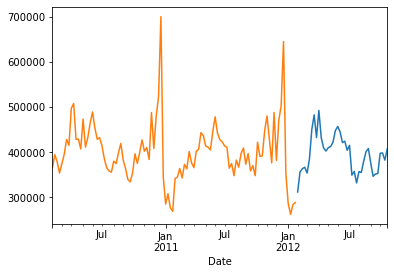

Department 26


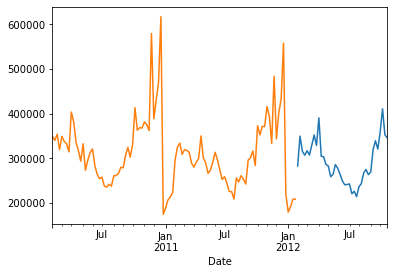

Department 27


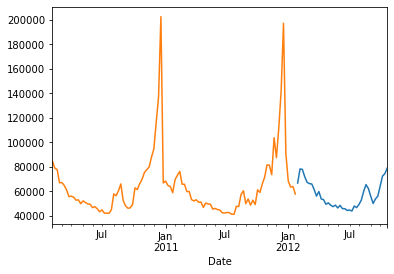

Department 28


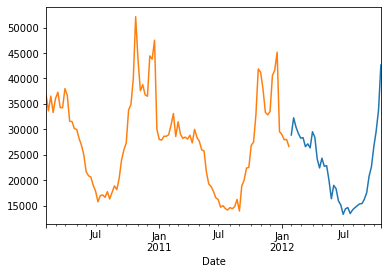

Department 29


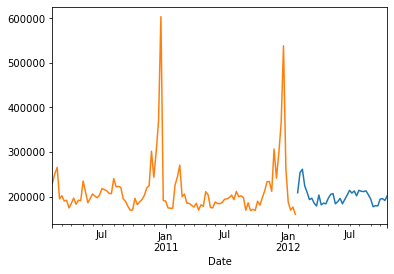

Department 30


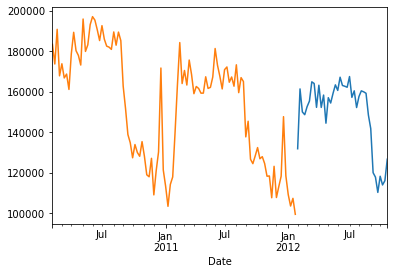

Department 31


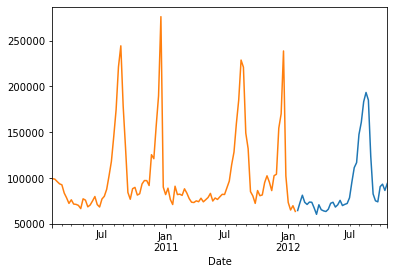

Department 32


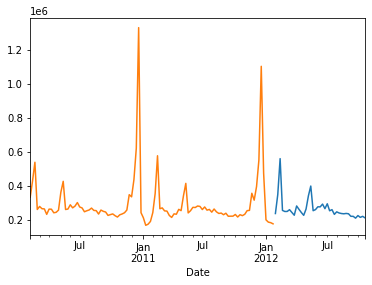

Department 33


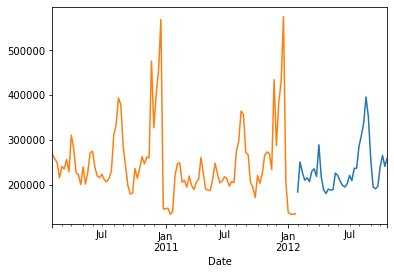

Department 34


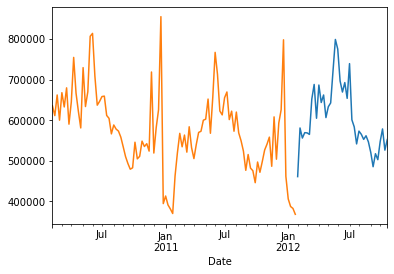

Department 35


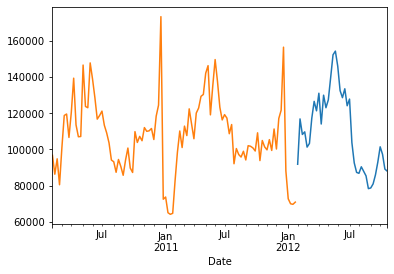

Department 36


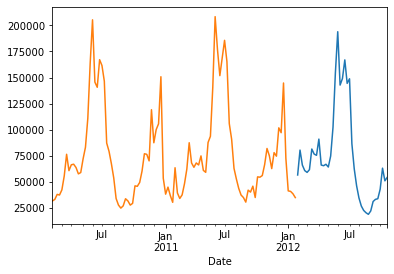

Department 37


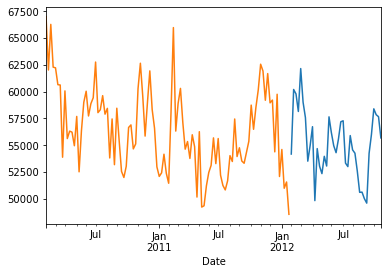

Department 38


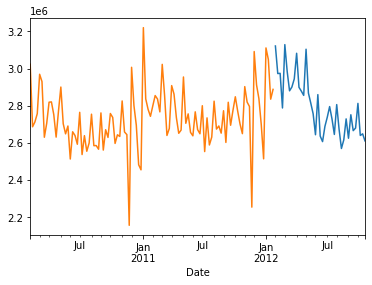

Department 39


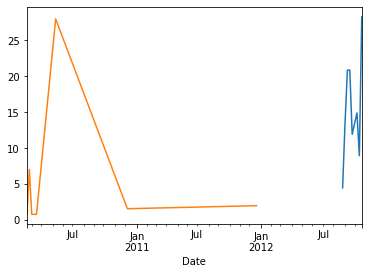

Department 40


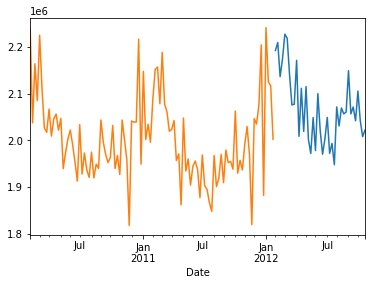

Department 41


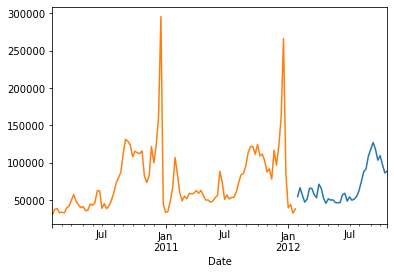

Department 42


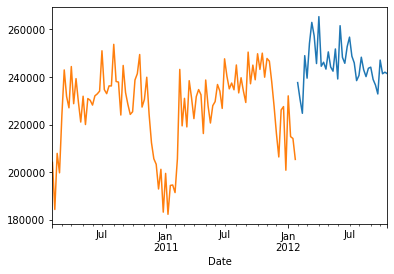

Department 43


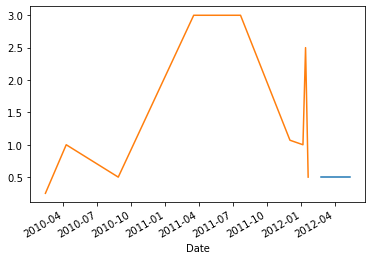

Department 44


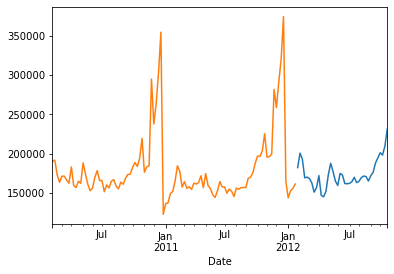

Department 45


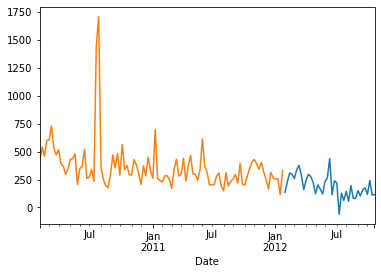

Department 46


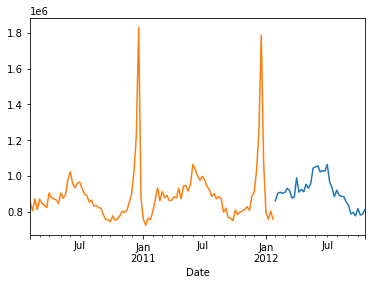

Department 47


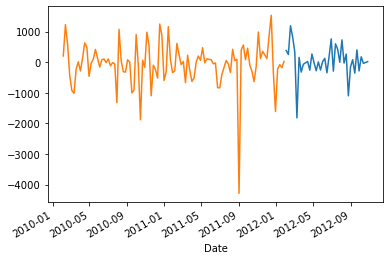

Department 48


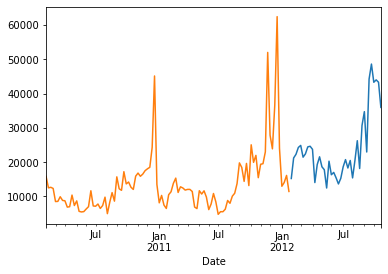

Department 49


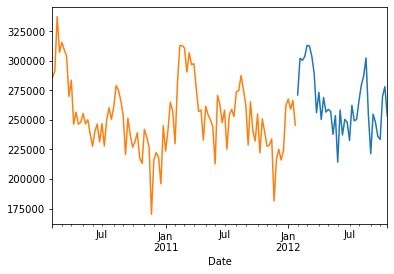

Department 50


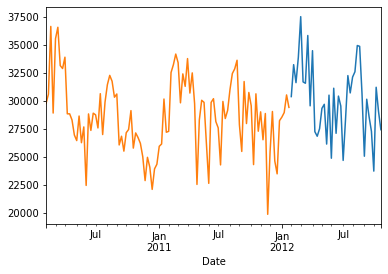

Department 51


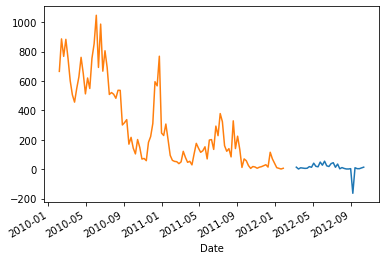

Department 52


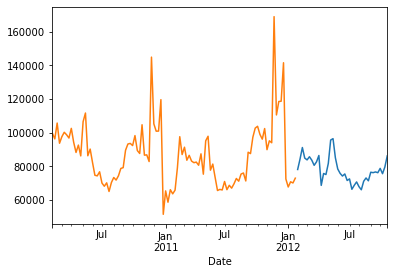

Department 53


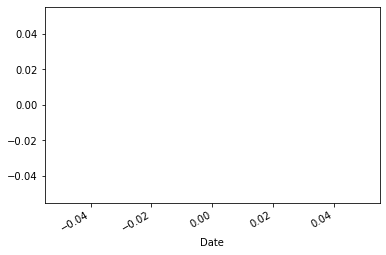

Department 54


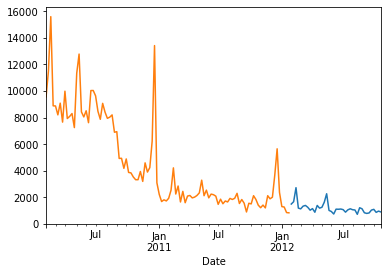

Department 55


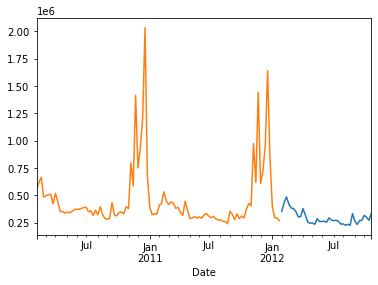

Department 56


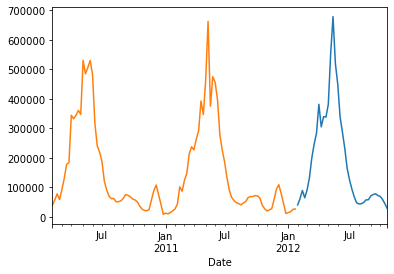

Department 57


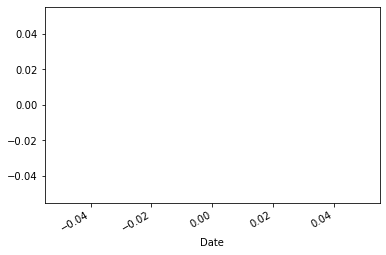

Department 58


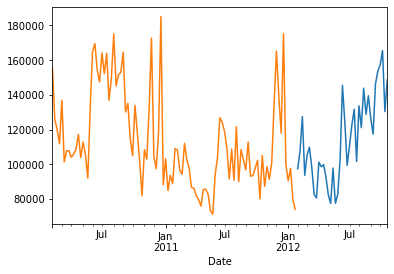

Department 59


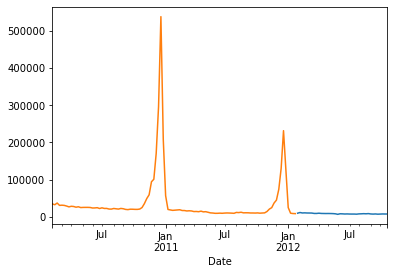

Department 60


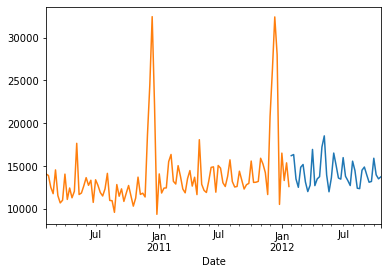

Department 61


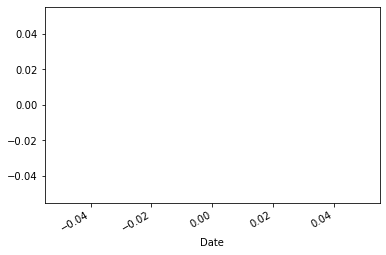

Department 62


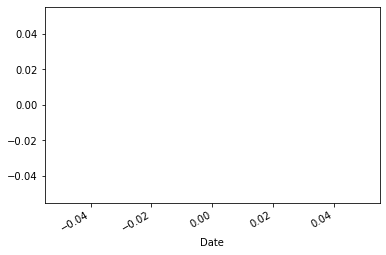

Department 63


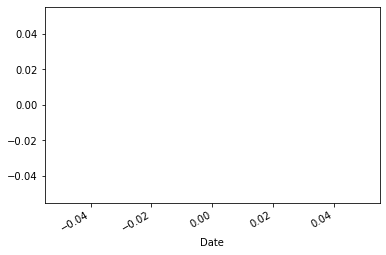

Department 64


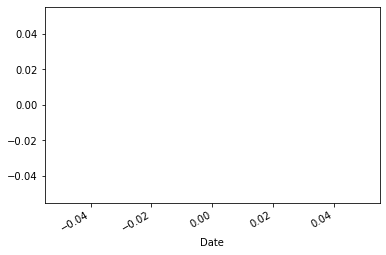

Department 65


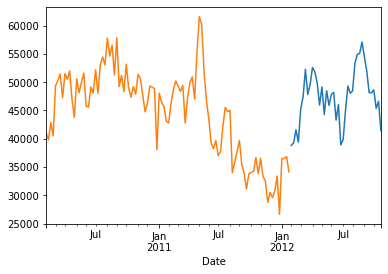

Department 66


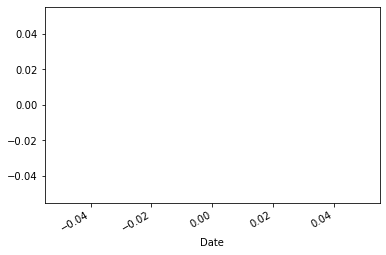

Department 67


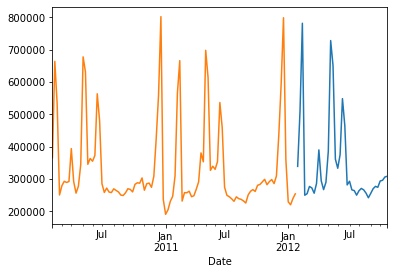

Department 68


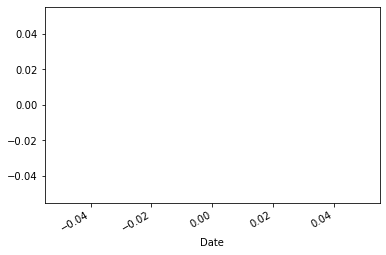

Department 69


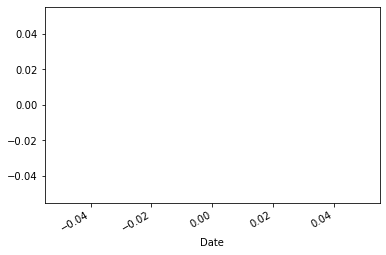

Department 70


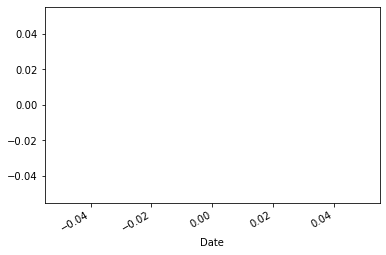

Department 71


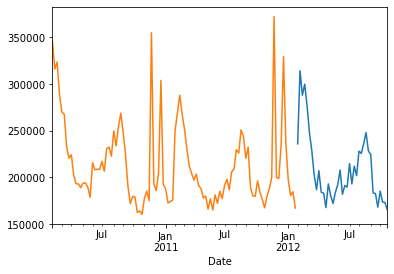

Department 72


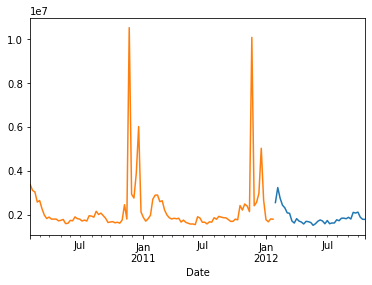

Department 73


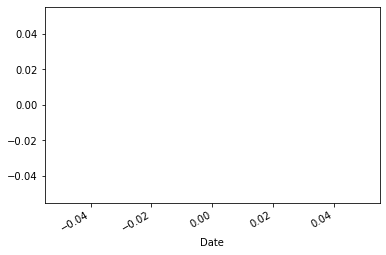

Department 74


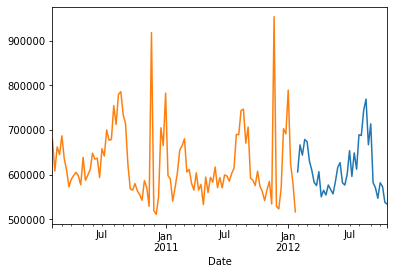

Department 75


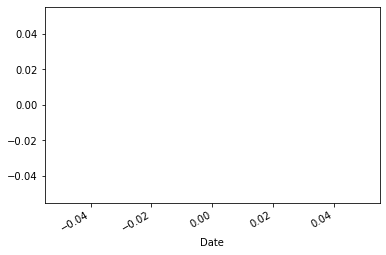

Department 76


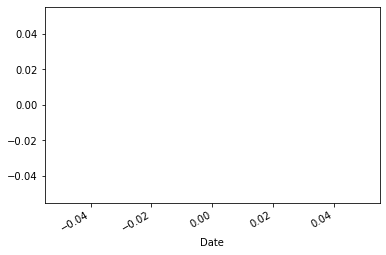

Department 77


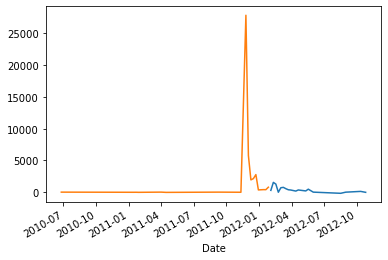

Department 78


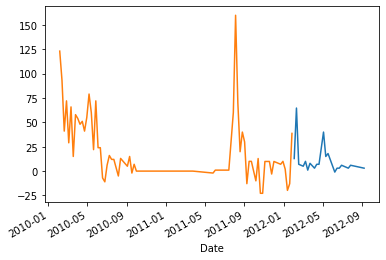

Department 79


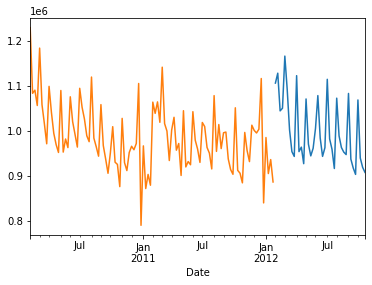

Department 80


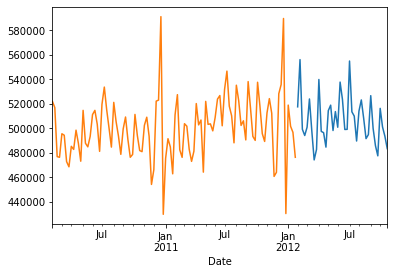

Department 81


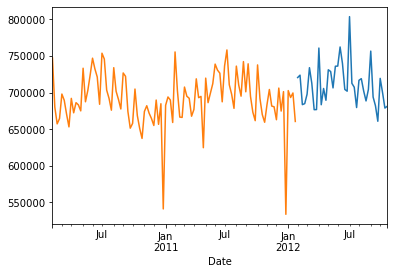

Department 82


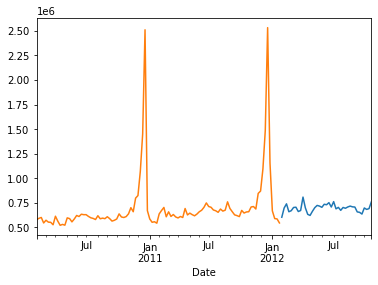

Department 83


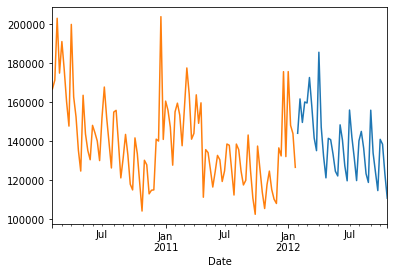

Department 84


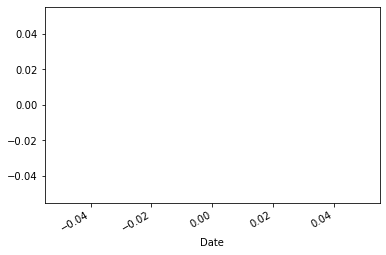

Department 85


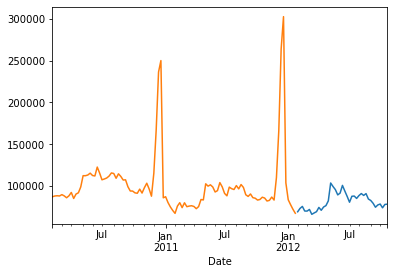

Department 86


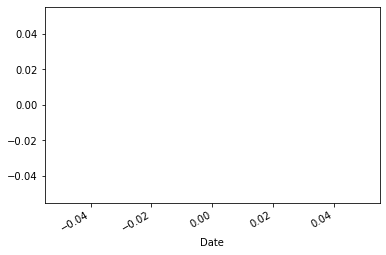

Department 87


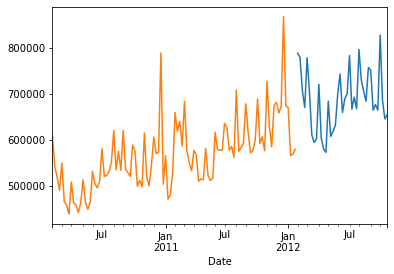

Department 88


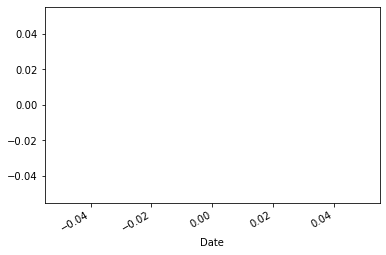

Department 89


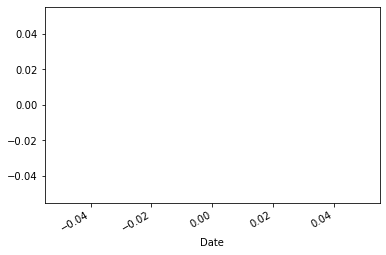

Department 90


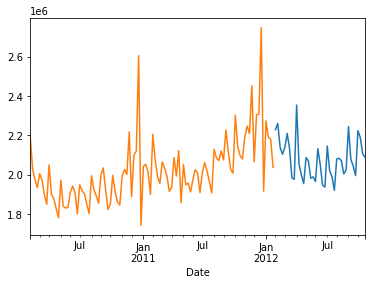

Department 91


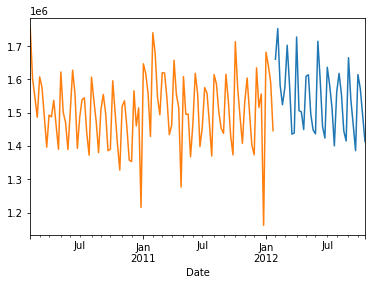

Department 92


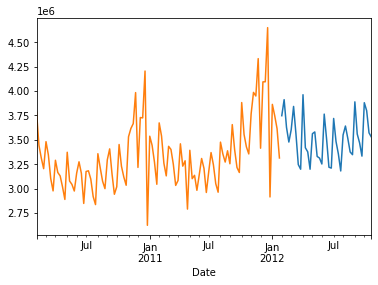

Department 93


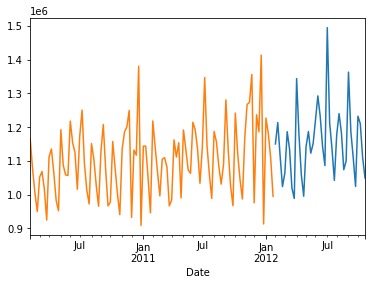

Department 94


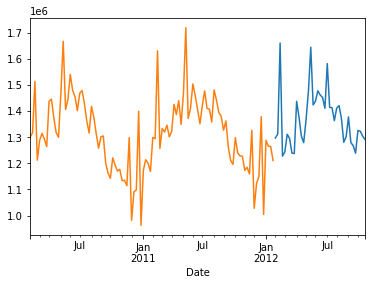

Department 95


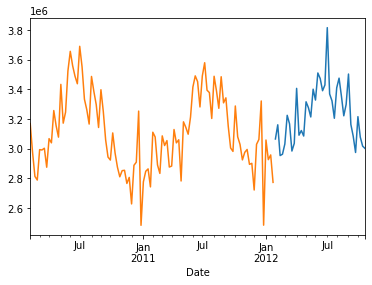

Department 96


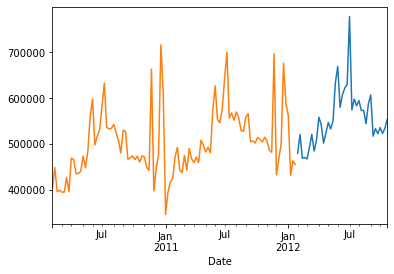

Department 97


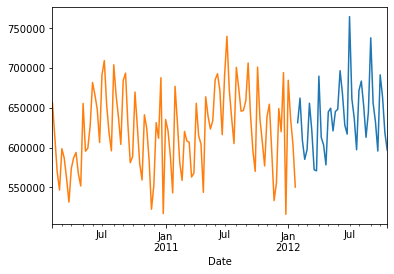

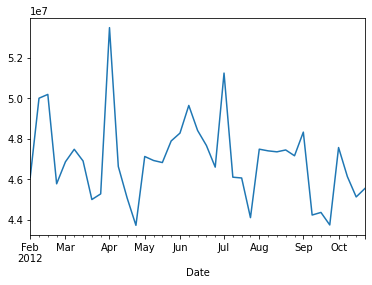

In [27]:
for i in range(1, 98):
    print(f'Department {i}')
    test_full[test_full.Dept==i].groupby('Date')['Weekly_Sales'].sum().plot()
    train_full[train_full.Dept==i].groupby('Date')['Weekly_Sales'].sum().plot()
    plt.show()
test_full.groupby('Date')['Weekly_Sales'].sum().plot()
plt.show()

#### Additional ad-hoc plots

<AxesSubplot:title={'center':'Weekly_Sales'}, xlabel='Dept'>

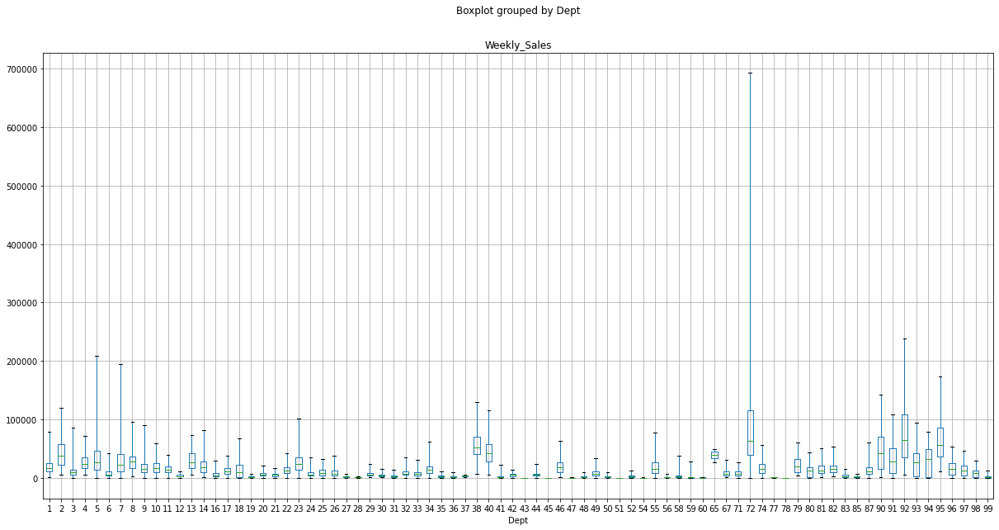

In [28]:
train_full[train_full.IsHoliday==True].boxplot(column='Weekly_Sales', by='Dept',
                             figsize=(20,10),whis=200)

<AxesSubplot:title={'center':'Weekly_Sales'}, xlabel='Store'>

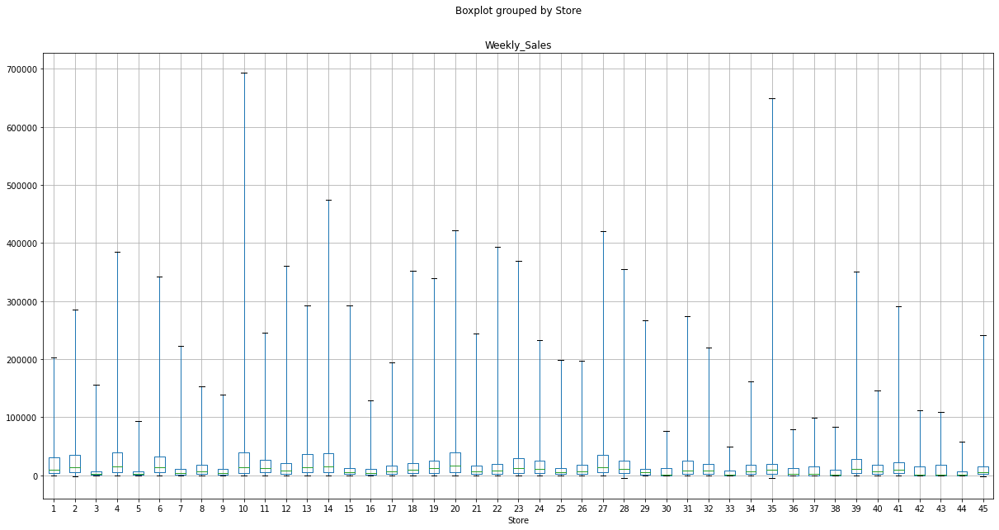

In [29]:
train_full.boxplot(column='Weekly_Sales', by='Store',
                             figsize=(20,10), whis=200) 

## Variable Selection Pages

In [30]:
layout = Layout(
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    margin=dict(
        l=10,
        r=10,
        b=50,
        t=50,
        pad=1
    ),
    title='Correlation Matrix',
    width=1800
)
corr_train = train_full_feat.corr()

corr_fig = go.Figure(data=go.Table(
                                header=dict(values=list(corr_train.columns),
                                            align='left', height=30),
                                cells=dict(values=[np.round(corr_train[col], 2) for col in corr_train.columns],
                                           align=['left'], height=30)), layout=layout)
corr_fig.show()
corr_fig.write_html('assets/img/corr_fig.html')

In [31]:
var = ['Store', 'Dept', 'Date','Month', 'Year', 'Week_of_Year', 'Day_of_Month',
       'Week_of_Month', 
       'Holiday_Label', 'Type', 'Size', 'Temperature', 
       'Fuel_Price', 'Promo1', 'Promo2','Promo3', 'Promo4',
       'Promo5', 'Missing_Promo_Data','CPI', 'Unemployment','Inventory', 
       ]

var_table =  pd.DataFrame(var, columns=['Variable'])
var_table['Variable Type'] = train_full_feat[var].dtypes.values
var_table['Variable Type'] = var_table.apply(lambda row: 'Integer' if row['Variable Type'] in ['int64', 'int32', 'float64'] else \
                                                         'Date' if row['Variable Type']=='datetime64[ns]' else \
                                                         'String' if row['Variable Type']=='object' else \
                                                         'Boolean (True / False)', axis=1)
var_table['Model(s)'] =  ['Random Forest', 'Random Forest', 'Random Forest','Regression & Random Forest', 
                          'Regression & Random Forest', 'Regression & Random Forest', 'Regression & Random Forest',
                       'Regression & Random Forest', 'Regression & Random Forest', 
                       'Regression & Random Forest',  'Regression & Random Forest', 'Regression & Random Forest', 
                       'Regression & Random Forest', 'Regression & Random Forest', 'Regression & Random Forest',
                       'Regression & Random Forest', 'Regression & Random Forest', 'Regression & Random Forest',
                       'Regression & Random Forest', 'Regression & Random Forest', 'Random Forest', 'Regression & Random Forest']
var_table['Notes'] =  ['', '', '','Dummy variable coding in linear regression', 
                       '', '', '',
                       'Dummy variable coding in linear regression', 'Dummy variable coding in linear regression', 
                       'Dummy variable coding in linear regression',  '', '', 
                       '', '', '',
                       '', '', '',
                       'Dummy variable coding in linear regression', '', '', '']

var_table

,Variable,Variable Type,Model(s),Notes
0,Store,Integer,Random Forest,
1,Dept,Integer,Random Forest,
2,Date,Date,Random Forest,
3,Month,Integer,Regression & Random Forest,Dummy variable coding in linear regression
4,Year,Integer,Regression & Random Forest,
5,Week_of_Year,Integer,Regression & Random Forest,
6,Day_of_Month,Integer,Regression & Random Forest,
7,Week_of_Month,String,Regression & Random Forest,Dummy variable coding in linear regression
8,Holiday_Label,String,Regression & Random Forest,Dummy variable coding in linear regression
9,Type,String,Regression & Random Forest,Dummy variable coding in linear regression


In [32]:
layout = Layout(
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    margin=dict(
        l=10,
        r=10,
        b=50,
        t=50,
        pad=1
    ),
    title='Variables Selected for Usage',
    width=800
)
var_fig = go.Figure(data=go.Table(
                                header=dict(values=list(var_table.columns),
                                            align='left'),
                                cells=dict(values=[var_table['Variable'], var_table['Variable Type'],
                                                   var_table['Model(s)'], var_table['Notes']],
                                           align=['left'], height=30)), layout=layout)
var_fig.show()

var_fig.write_html('assets/img/variable_fig.html')

# Modeling

#### Define custom error metric

In [33]:
def weighted_mean_abs_err(actuals, predictions, holidays):
    hol_weight = holidays.replace(True, 5).replace(False,1)
    weighted_pred_error = np.sum(hol_weight * abs(actuals-predictions))
    total_weights = np.sum(hol_weight)
    return round(weighted_pred_error / total_weights, 3)
    

### Linear Regression

#### Create Training and Test Datasets with the desired variables

In [34]:
X_train = train_full_feat.drop(['Store', 'Dept', 'Type', 'Month', 'Week_of_Month', 'Holiday_Label',
                                'Date', 'IsHoliday', 'Temperature_Bin', 'Weekly_Sales'], axis=1, errors='ignore').fillna(0)
Y_train = train_full_feat['Weekly_Sales'].copy()

In [35]:
X_test = test_full_feat.drop(['Store', 'Dept', 'Type', 'Month', 'Week_of_Month', 'Holiday_Label',
                              'Date', 'IsHoliday', 'Temperature_Bin', 'Weekly_Sales'], axis=1, errors='ignore').fillna(0)
X_test[['Holiday_3. Thanksgiving', 'Holiday_4. Pre-Christmas', 'Holiday_5. Christmas', 'Month_11', 'Month_12', 'Temp_10']] = 0
Y_test = test_full_feat['Weekly_Sales'].copy()

In [36]:
X_train.columns[~X_train.columns.isin(X_test.columns)]


Index([], dtype='object')

In [37]:
X_test.columns[~X_test.columns.isin(X_train.columns)]

Index([], dtype='object')

#### Create Regression Model and Obtain Error Metrics and Forecast

In [38]:
reg = LinearRegression()
reg.fit(X_train, Y_train)
Y_pred = reg.predict(X_test)
Y_pred.tolist()

[16588.460709486855,
 16625.44689244381,
 16576.131981834536,
 16563.803254182218,
 16539.145798877813,
 16600.789437139174,
 16625.44689244381,
 16563.803254182218,
 16551.47452653013,
 16600.789437139174,
 16613.118164791493,
 16588.460709486855,
 16625.44689244381,
 16551.47452653013,
 16514.488343573175,
 16576.131981834536,
 16563.803254182218,
 16588.460709486855,
 16551.47452653013,
 16576.131981834536,
 16576.131981834536,
 16526.817071225494,
 16600.789437139174,
 16613.118164791493,
 16539.145798877813,
 16551.47452653013,
 16539.145798877813,
 16514.488343573175,
 16576.131981834536,
 16625.44689244381,
 16576.131981834536,
 16600.789437139174,
 16613.118164791493,
 16600.789437139174,
 16588.460709486855,
 16551.47452653013,
 16514.488343573175,
 16539.145798877813,
 16563.803254182218,
 16576.131981834536,
 16588.460709486855,
 16526.817071225494,
 16563.803254182218,
 16588.460709486855,
 16563.803254182218,
 16600.789437139174,
 16526.817071225494,
 16551.47452653013,
 1

In [39]:
lin_reg_error = weighted_mean_abs_err( Y_test, Y_pred, test_full_feat['IsHoliday'])
print(f'Error Metric Value for linear regression is: {lin_reg_error}')

Error Metric Value for linear regression is: 14752.837


In [40]:
layout = Layout(
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    margin=dict(
        l=10,
        r=10,
        b=50,
        t=50,
        pad=1
    ),
    title='Model Evaluation',
    width=500
)

reg_wmae = pd.DataFrame({'Error Metric': 'Weighted Mean Absolute Error',
                         'Value': [lin_reg_error]})
reg_wmae
lin_wmae = go.Figure(data=go.Table(
                                header=dict(values=list(reg_wmae.columns),
                                            align='left'),
                                cells=dict(values=[reg_wmae['Error Metric'], reg_wmae['Value']],
                                                  
                                           align=['left'], height=30)), layout=layout)
lin_wmae.show()

lin_wmae.write_html('assets/img/reg_wmae.html')

In [41]:
layout = Layout(
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    margin=dict(
        l=10,
        r=10,
        b=50,
        t=50,
        pad=1
    ),
    title='Feb 2012 - Nov 2012 Weekly Sales Predictions (Linear Regression)'
)

test = pd.concat([test_full_feat.Date, Y_test, pd.DataFrame(Y_pred)], axis=1)
test.columns = ['Date', 'Weekly_Sales_Actual', 'Weekly_Sales_Predict']
df = test.groupby('Date')[['Weekly_Sales_Actual', 'Weekly_Sales_Predict']].sum().reset_index()
fig = go.Figure(layout=layout, layout_yaxis_range=[20000000,80000000])
fig.add_trace(go.Scatter(x=df['Date'], y=df['Weekly_Sales_Actual'], mode='lines', name='Actual Values'))
fig.add_trace(go.Scatter(x=df['Date'], y=df['Weekly_Sales_Predict'], mode='lines', name='Predicted Values'))
fig.show()
fig.write_html('assets/img/reg_graph_fig.html')

## Random Forest

#### Obtain extended feature set for Random Forest

In [42]:

train_full_feat = add_features(train_full, train_month=True, add_dummies=False)
test_full_feat = add_features(test_full, train_month=False, add_dummies=False)

In [43]:
X_train = train_full_feat[['Store','Dept','IsHoliday','Size','Week_of_Year','Type_Bin','Year', 
                           'Temperature_Bin', 'Holiday_Label_Bin', 'Week_of_Month_Bin',
                           'Promo1', 'Promo2', 'Promo3', 'Promo4', 'Promo5']].fillna(0)

X_test = test_full_feat[['Store','Dept','IsHoliday','Size','Week_of_Year','Type_Bin','Year',
                         'Temperature_Bin','Holiday_Label_Bin', 'Week_of_Month_Bin',
                         'Promo1', 'Promo2', 'Promo3', 'Promo4', 'Promo5']].fillna(0)

Y_train = train_full_feat['Weekly_Sales']
Y_test = test_full_feat['Weekly_Sales']

#### Fit Random Forest, test difference hyperparameters, and Obtain Error Metric

In [ ]:
from sklearn.ensemble import RandomForestRegressor

forest = RandomForestRegressor(n_estimators=58,  max_features=10, max_depth=27,
                                min_samples_leaf=1, min_samples_split=3)

# Fit the model
forest.fit(X_train, Y_train)

Y_preds = forest.predict(X_test)

# Compute WMAE on validation data
forest_error = weighted_mean_abs_err(Y_test, Y_preds, test_full_feat['IsHoliday'])
print(f'The Test Error  {forest_error}')

#### Get Error Table

In [ ]:
layout = Layout(
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    margin=dict(
        l=10,
        r=10,
        b=50,
        t=50,
        pad=1
    ),
    title='Model Evaluation',
    width=500
)

forest_error_df = pd.DataFrame({'Error Metric': 'Weighted Mean Absolute Error',
                                'Value': [forest_error]})

forest_error_fig = go.Figure(data=go.Table(
                                header=dict(values=list(forest_error_df.columns),
                                            align='left'),
                                cells=dict(values=[forest_error_df['Error Metric'], forest_error_df['Value']],
                                                  
                                           align=['left'], height=30)), layout=layout)
forest_error_fig.show()

forest_error_fig.write_html('assets/img/rf_wmae.html')

#### Get Feature Importance Chart

In [ ]:
importances = forest.feature_importances_
sorted_indices = np.argsort(importances)[::-1]
feat_imp = pd.DataFrame({'Variable': X_train.columns[sorted_indices], 'Importance': importances[sorted_indices]})

importance_fig = plotly_bar(feat_imp, 'Variable', 'Importance', title=f'Feature Importance')
importance_fig.write_html('assets/img/rf_imp_fig.html')

#### Graph Actuals and Predictions for Test Dataset

In [ ]:
test = pd.concat([test_full_feat.Date, Y_test, pd.DataFrame(Y_preds)], axis=1)
test.columns = ['Date', 'Weekly_Sales_Actual', 'Weekly_Sales_Predict']
test.groupby('Date')[['Weekly_Sales_Actual', 'Weekly_Sales_Predict']].sum().plot()

In [ ]:
layout = Layout(
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    margin=dict(
        l=10,
        r=10,
        b=50,
        t=50,
        pad=1
    ),
    title='Feb 2012 - Nov 2012 Weekly Sales Predictions (Random Forest)'
)
df = test.groupby('Date')[['Weekly_Sales_Actual', 'Weekly_Sales_Predict']].sum().reset_index()
fig = go.Figure(layout=layout, layout_yaxis_range=[35000000,60000000])
fig.add_trace(go.Scatter(x=df['Date'], y=df['Weekly_Sales_Actual'], mode='lines', name='Actual Values'))
fig.add_trace(go.Scatter(x=df['Date'], y=df['Weekly_Sales_Predict'], mode='lines', name='Predicted Values'))
fig.show()
fig.write_html('assets/img/rf_graph_fig.html')